<a href="https://colab.research.google.com/github/surensnyper/ys_project_001/blob/main/Surveillance.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from keras.preprocessing.image import img_to_array,load_img
import numpy as np
import glob
import os 
import cv2
from keras.layers import Conv3D,ConvLSTM2D,Conv3DTranspose
from keras.models import Sequential
from keras.callbacks import ModelCheckpoint, EarlyStopping
import imutils

In [2]:
# !tar -xvf /content/drive/MyDrive/장영선/Daily/UCSD_Anomaly_Dataset.tar.gz
# !unzip /content/drive/MyDrive/장영선/Daily/Avenue_Dataset.zip -d /content/train
!unzip /content/drive/MyDrive/장영선/Daily/Avenue_Dataset.zip

Archive:  /content/drive/MyDrive/장영선/Daily/Avenue_Dataset.zip
   creating: Avenue Dataset/
   creating: Avenue Dataset/testing_vol/
  inflating: Avenue Dataset/testing_vol/vol20.mat  
  inflating: Avenue Dataset/testing_vol/vol04.mat  
  inflating: Avenue Dataset/testing_vol/vol06.mat  
  inflating: Avenue Dataset/testing_vol/vol21.mat  
  inflating: Avenue Dataset/testing_vol/vol19.mat  
  inflating: Avenue Dataset/testing_vol/vol16.mat  
  inflating: Avenue Dataset/testing_vol/vol02.mat  
  inflating: Avenue Dataset/testing_vol/vol01.mat  
  inflating: Avenue Dataset/testing_vol/vol07.mat  
  inflating: Avenue Dataset/testing_vol/vol10.mat  
  inflating: Avenue Dataset/testing_vol/vol03.mat  
  inflating: Avenue Dataset/testing_vol/vol05.mat  
  inflating: Avenue Dataset/testing_vol/vol17.mat  
  inflating: Avenue Dataset/testing_vol/vol18.mat  
  inflating: Avenue Dataset/testing_vol/vol15.mat  
  inflating: Avenue Dataset/testing_vol/vol13.mat  
  inflating: Avenue Dataset/te

In [38]:
store_image = []
train_path='/content/Avenue Dataset/training_videos'
fps=5
train_videos=os.listdir(train_path)
train_images_path=train_path+'/frames'
os.makedirs(train_images_path, exist_ok=True)
def store_inarray(image_path):
    image=load_img(image_path)
    image=img_to_array(image)
    image=cv2.resize(image, (227,227), interpolation = cv2.INTER_AREA)
    gray=0.2989*image[:,:,0]+0.5870*image[:,:,1]+0.1140*image[:,:,2]
    store_image.append(gray)

In [39]:
for video in train_videos:
    os.system( 'ffmpeg -i {}/{} -r 1/{}  {}/frames/%03d.jpg'.format(train_path,video,fps,train_path))
    images=os.listdir(train_images_path)
    for image in images:
        image_path=train_images_path + '/' + image
        store_inarray(image_path)

In [41]:
store_image=np.array(store_image)

a,b,c=store_image.shape
store_image.resize(b,c,a)
store_image=(store_image-store_image.mean())/(store_image.std())
store_image=np.clip(store_image,0,1)
np.save('training.npy',store_image)

ValueError: ignored

In [11]:
stae_model=Sequential()
stae_model.add(Conv3D(filters=128,kernel_size=(11,11,1),strides=(4,4,1),padding='valid',input_shape=(227,227,10,1),activation='tanh'))
stae_model.add(Conv3D(filters=64,kernel_size=(5,5,1),strides=(2,2,1),padding='valid',activation='tanh'))
stae_model.add(ConvLSTM2D(filters=64,kernel_size=(3,3),strides=1,padding='same',dropout=0.4,recurrent_dropout=0.3,return_sequences=True))
stae_model.add(ConvLSTM2D(filters=32,kernel_size=(3,3),strides=1,padding='same',dropout=0.3,return_sequences=True))
stae_model.add(ConvLSTM2D(filters=64,kernel_size=(3,3),strides=1,return_sequences=True, padding='same',dropout=0.5))
stae_model.add(Conv3DTranspose(filters=128,kernel_size=(5,5,1),strides=(2,2,1),padding='valid',activation='tanh'))
stae_model.add(Conv3DTranspose(filters=1,kernel_size=(11,11,1),strides=(4,4,1),padding='valid',activation='tanh'))
stae_model.compile(optimizer='adam',loss='mean_squared_error',metrics=['accuracy'])

In [12]:
training_data=np.load('training.npy')
frames=training_data.shape[2]
frames=frames-frames%10
training_data=training_data[:,:,:frames]
training_data=training_data.reshape(-1,227,227,10)
training_data=np.expand_dims(training_data,axis=4)
target_data=training_data.copy()
epochs=10
batch_size=1

In [13]:
callback_save = ModelCheckpoint("saved_model.h5", monitor="mean_squared_error", save_best_only=True)
callback_early_stopping = EarlyStopping(monitor='val_loss', patience=3)
stae_model.fit(training_data, target_data, batch_size=batch_size, epochs=epochs, callbacks = [callback_save,callback_early_stopping])
stae_model.save("saved_model.h5")

Epoch 1/10


ValueError: ignored

In [ ]:
import cv2
import numpy as np 
from keras.models import load_model
import argparse
from PIL import Image
import imutils

In [ ]:
def mean_squared_loss(x1,x2):
    difference=x1-x2
    a,b,c,d,e=difference.shape
    n_samples=a*b*c*d*e
    sq_difference=difference**2
    Sum=sq_difference.sum()
    distance=np.sqrt(Sum)
    mean_distance=distance/n_samples
    return mean_distance

In [ ]:
model=load_model("saved_model.h5")

In [99]:
cap = cv2.VideoCapture("/content/videoplayback3.mp4")
print(cap.isOpened())

True


In [100]:
cap.isOpened()

True

In [101]:
from google.colab.patches import cv2_imshow

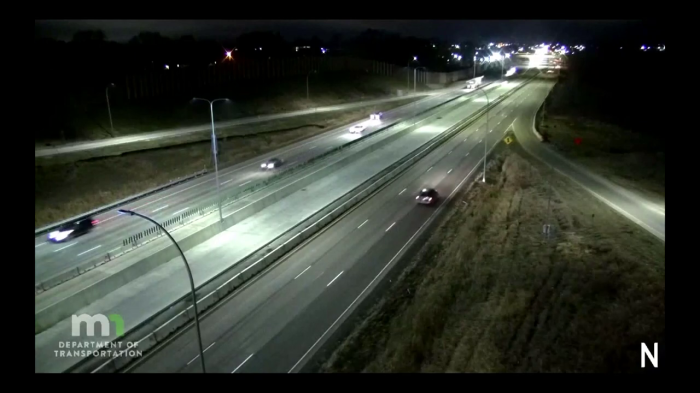

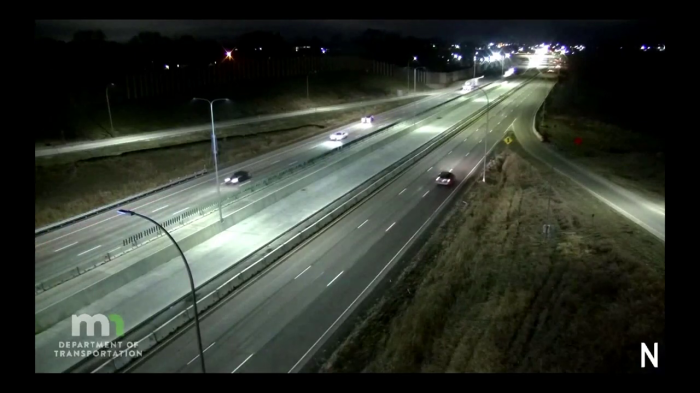

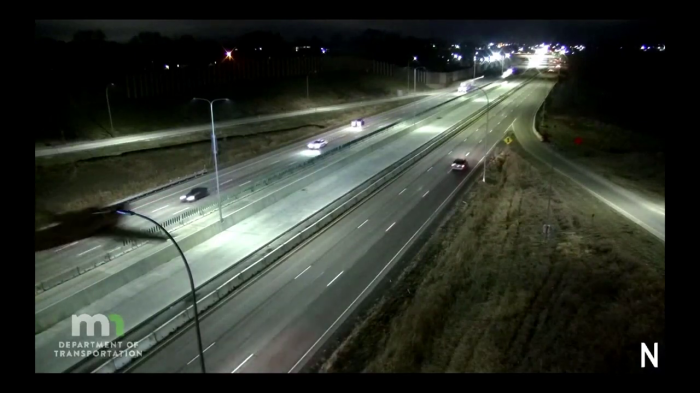

Abnormal Event Detected


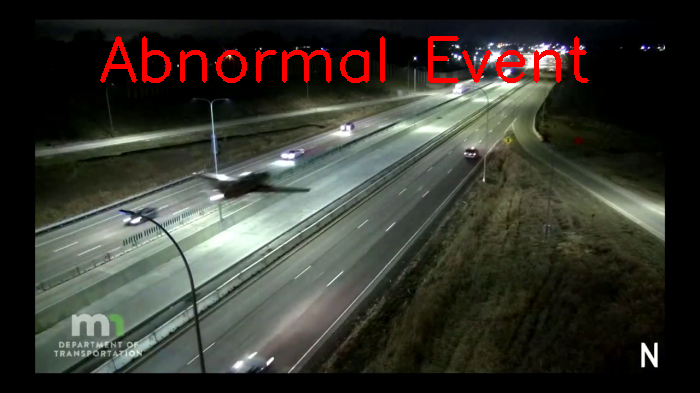

Abnormal Event Detected


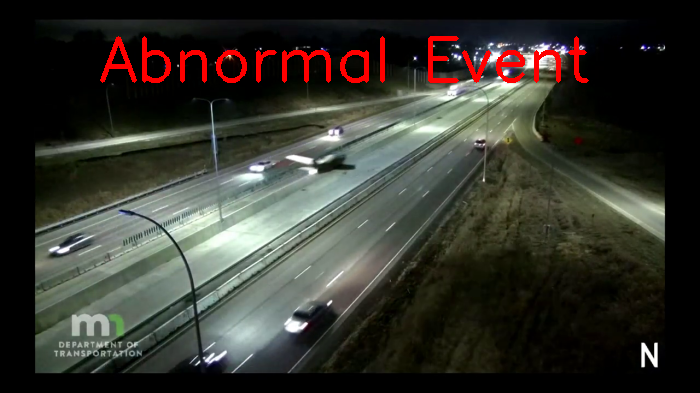

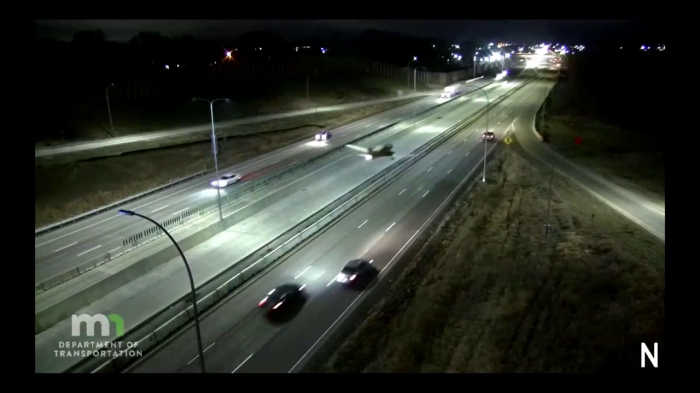

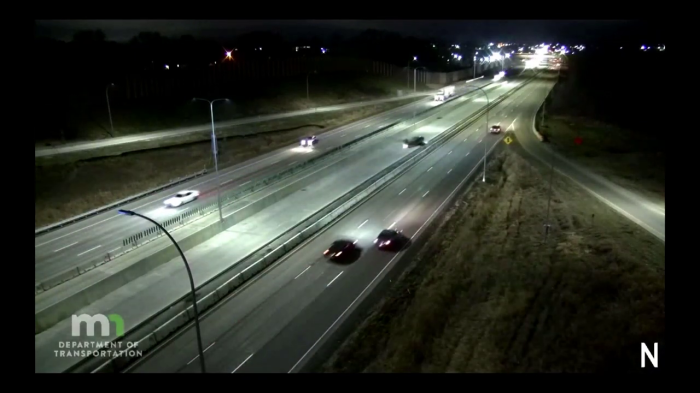

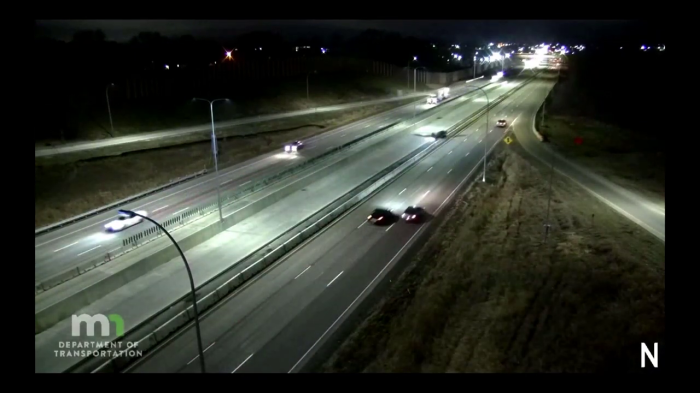

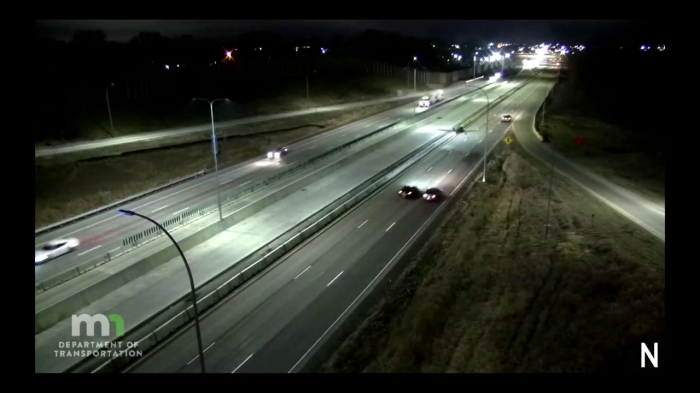

...

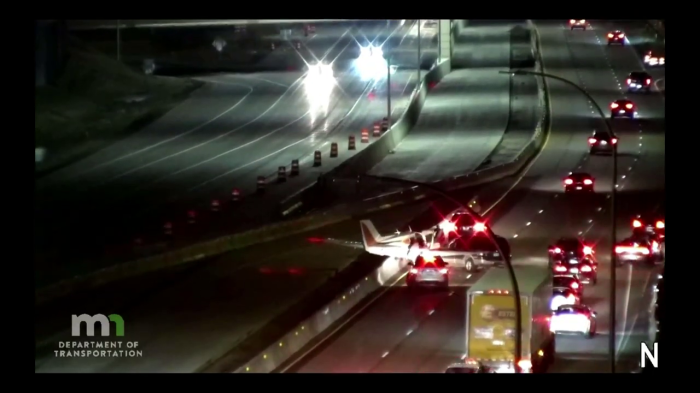

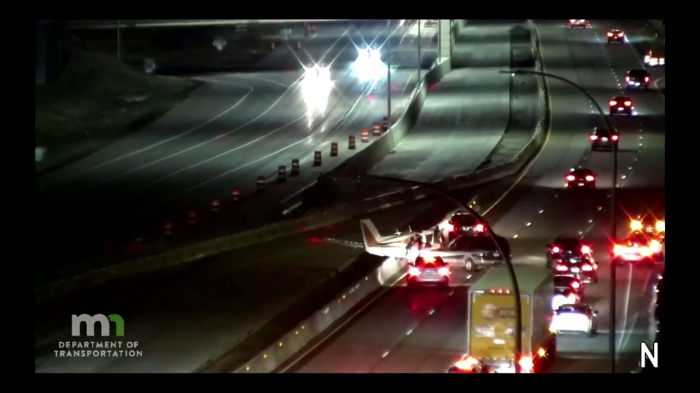

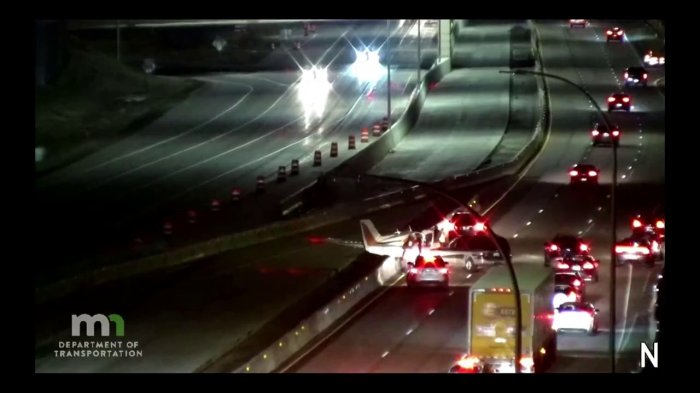

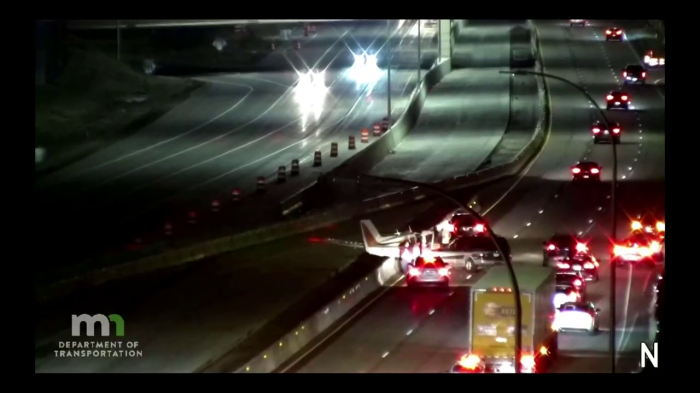

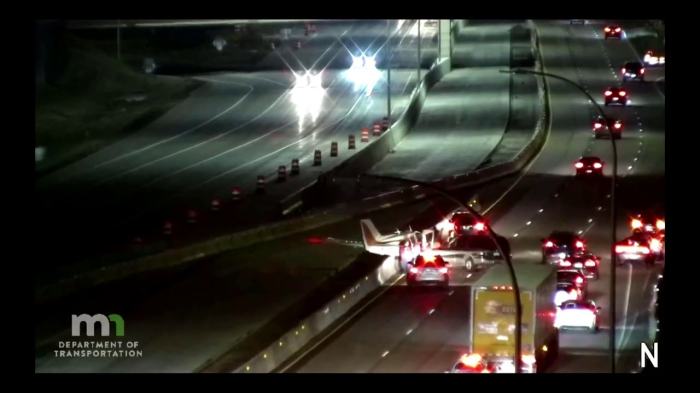

KeyboardInterrupt: ignored

In [102]:
while cap.isOpened():
    imagedump=[]
    ret,frame=cap.read()
    
    for i in range(10):
      ret,frame=cap.read()
      image = imutils.resize(frame,width=700,height=600)
      
      frame=cv2.resize(frame, (227,227), interpolation = cv2.INTER_AREA)
      gray=0.2989*frame[:,:,0]+0.5870*frame[:,:,1]+0.1140*frame[:,:,2]
      gray=(gray-gray.mean())/gray.std()
      gray=np.clip(gray,0,1)
      imagedump.append(gray)

    imagedump=np.array(imagedump)
    imagedump.resize(227,227,10)
    imagedump=np.expand_dims(imagedump,axis=0)
    imagedump=np.expand_dims(imagedump,axis=4)
    output=model.predict(imagedump)
    loss=mean_squared_loss(imagedump,output)

    if frame.any()==None:
        print("none")
    if cv2.waitKey(10) & 0xFF==ord('q'):
        break
    if loss>0.00068:
        print('Abnormal Event Detected')
        cv2.putText(image,"Abnormal Event",(100,80),cv2.FONT_HERSHEY_SIMPLEX,2,(0,0,255),4)
    cv2_imshow(image)
    
cap.release()
cv2.destroyAllWindows()